More pancreatic cells were discovered after merging E15.5 cells into E12.5 and E17.5 cells. This notebook is used to do further pancreatic cell removal based on the original frozen datasets. The found pancreatic cell are removed using the following procedures. However, cytotrace and pathway scores are not re-calculated. 

In [1]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

import warnings
warnings.filterwarnings("ignore")

import scanpy as sc
import PlotGenerators as helper
import numpy as np

import importlib
importlib.reload(helper)

from sklearn.metrics import adjusted_rand_score as ari

# To be used to hold the data after removing pancreatic cells.
out_dir = '/Volumes/ssd/results/missy_sc_rna/bmi1/h5ad/frozen_09012023/'
checking_genes = {
    'Other_Genes': ['Gm42418', 'Rpgrip1', 'AY036118'],
    'Pancreas': ['CPA1', 'CPA2', 'CLPS', 'PNLIP', 'PTF1A'],
    'K/L Cells': ['GIP', 'TMEM190', 'GCG', 'FABP5', 'SCG5', 'AMN'] # Used as a control
}

In [2]:
def check_pancreatic_genes(adata, genes):
    # Make sure genes are in the adata
    genes = [gene for gene in genes if gene in adata.var_names]
    color = ['leiden']
    color.extend(genes)
    sc.pl.umap(adata, color=color, wspace=0.05, legend_loc='on data')
    sc.pl.violin(adata, keys=genes, groupby='leiden')
    sc.tl.rank_genes_groups(adata, groupby='leiden')
    groups = adata.obs['leiden'].unique()
    rank_genes_df = sc.get.rank_genes_groups_df(adata, group=groups)
    # print(rank_genes_df.head())
    rank_genes_df_genes = rank_genes_df[rank_genes_df['names'].isin(genes)]
    rank_genes_df_genes.sort_values(by='scores', inplace=True, ascending=False)
    display(HTML(rank_genes_df_genes.to_html()))

../resources/adata_12_frozen.h5ad
Checking Other_Genes


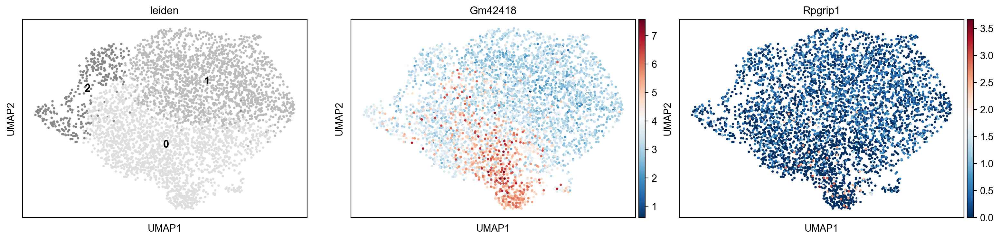

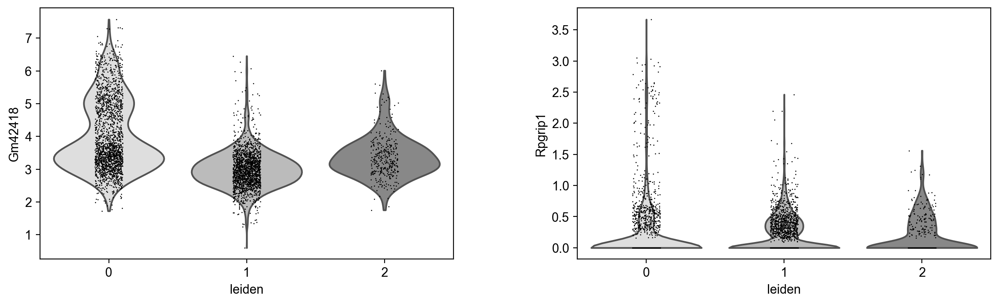

,group,names,scores,logfoldchanges,pvals,pvals_adj
0,0,Gm42418,35.181610,1.429444,2.264868e-229,2.371450e-226
28171,1,Rpgrip1,1.183262,0.103202,2.367744e-01,3.483127e-01
4690,0,Rpgrip1,-0.596640,-0.055783,5.507886e-01,6.510849e-01
49696,2,Rpgrip1,-1.184613,-0.154358,2.367457e-01,3.967600e-01
52901,2,Gm42418,-4.097124,-0.231892,4.837622e-05,4.604160e-04
35599,1,Gm42418,-36.603176,-1.391200,3.217476e-252,3.818071e-249


Checking Pancreas


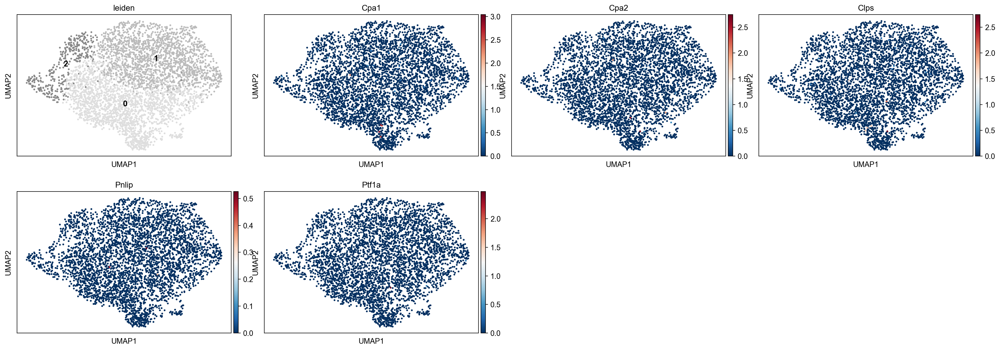

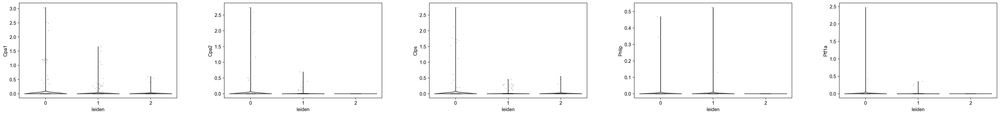

,group,names,scores,logfoldchanges,pvals,pvals_adj
163,0,Clps,2.117417,1.617552,0.034331,0.062427
235,0,Cpa2,1.899028,2.304260,0.057691,0.099342
278,0,Cpa1,1.805821,1.064916,0.071051,0.119594
1522,0,Ptf1a,0.808142,1.824924,0.419096,0.528022
2730,0,Pnlip,0.237870,0.373254,0.811994,0.866101
30863,1,Pnlip,0.070821,0.112417,0.943544,0.964638
32721,1,Ptf1a,-0.669723,-1.339135,0.503091,0.618568
48975,2,Clps,-0.786098,-0.639614,0.432074,0.591063
50235,2,Ptf1a,-1.455373,-19.879913,0.145647,0.284987
34439,1,Cpa1,-1.501173,-0.837347,0.133394,0.218597


Checking K/L Cells


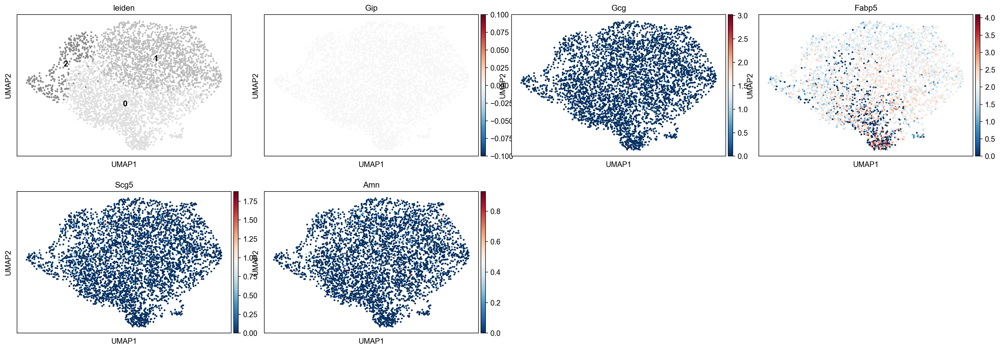

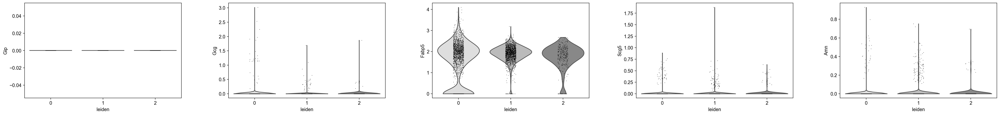

,group,names,scores,logfoldchanges,pvals,pvals_adj
18301,1,Fabp5,16.845627,0.616706,3.056054e-61,1.070822e-59
23564,1,Amn,4.432036,1.238769,9.640612e-06,2.938909e-05
139,0,Gcg,2.193931,1.073934,2.831871e-02,5.238755e-02
40124,2,Fabp5,1.951275,0.113523,5.161136e-02,1.381893e-01
42185,2,Scg5,1.266892,0.613770,2.059190e-01,3.606571e-01
30460,1,Scg5,0.236083,0.071027,8.133809e-01,8.714446e-01
3269,0,Gip,0.000000,0.000000,1.000000e+00,1.000000e+00
31061,1,Gip,0.000000,0.000000,1.000000e+00,1.000000e+00
47130,2,Gip,0.000000,0.000000,1.000000e+00,1.000000e+00
48119,2,Gcg,-0.356574,-0.284207,7.215797e-01,8.220679e-01


../resources/adata_15_frozen.h5ad
Checking Other_Genes


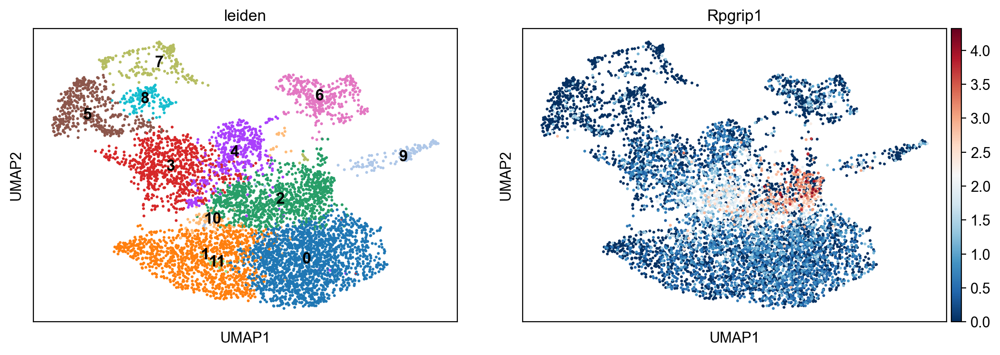

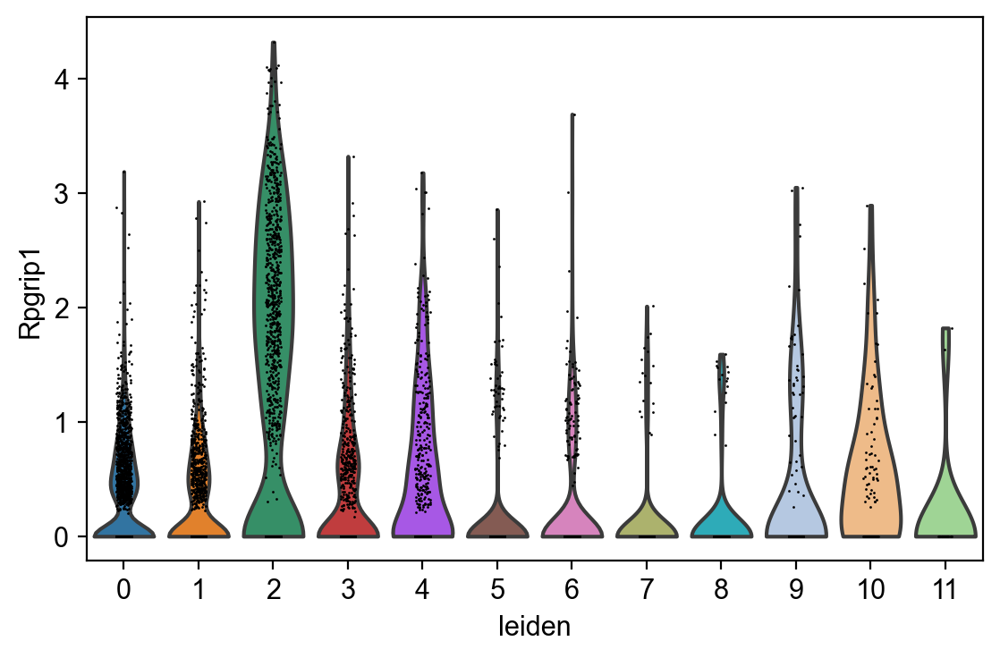

,group,names,scores,logfoldchanges,pvals,pvals_adj
39022,2,Rpgrip1,28.937756,2.613897,3.511977e-138,2.855091e-135
82046,4,Rpgrip1,1.577533,0.166111,1.152550e-01,2.478496e-01
201227,10,Rpgrip1,0.657744,0.140367,5.122952e-01,7.020221e-01
184024,9,Rpgrip1,-1.360967,-0.303414,1.756869e-01,2.557888e-01
222874,11,Rpgrip1,-3.036228,-1.820992,6.720599e-03,1.124191e-02
77948,3,Rpgrip1,-6.474725,-0.539599,1.409240e-10,6.364742e-09
135621,6,Rpgrip1,-9.329915,-1.155074,3.970380e-19,5.633898e-18
174378,8,Rpgrip1,-10.779865,-2.088242,7.516382e-21,1.000356e-19
38486,1,Rpgrip1,-12.110350,-0.832007,7.577550e-33,9.031496e-32
18987,0,Rpgrip1,-12.565570,-0.724295,8.954614e-36,7.456827e-35


Checking Pancreas


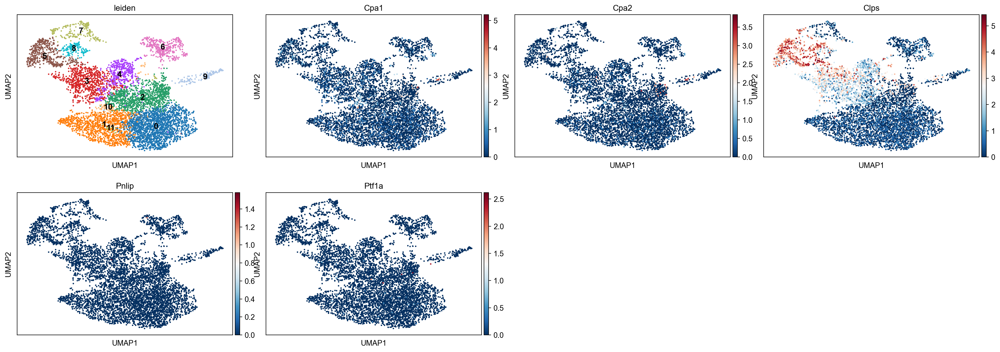

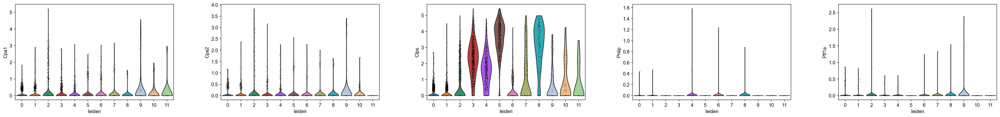

,group,names,scores,logfoldchanges,pvals,pvals_adj
97559,5,Clps,58.632477,4.103285,6.835738e-235,1.878480e-232
58534,3,Clps,34.503510,2.439235,8.417802e-172,8.211987e-168
156121,8,Clps,18.179836,3.119959,1.782746e-39,5.207059e-38
78103,4,Clps,14.625752,1.283939,1.841543e-41,5.060612e-39
39076,2,Cpa1,5.037906,1.061727,5.458032e-07,1.172686e-06
39105,2,Cpa2,3.240344,0.939350,1.227648e-03,1.927778e-03
176778,9,Cpa1,2.549560,1.578634,1.189521e-02,2.777163e-02
177115,9,Cpa2,2.043395,1.671118,4.294552e-02,8.193917e-02
39160,2,Ptf1a,1.474635,1.338066,1.405917e-01,1.621208e-01
140161,7,Clps,1.456243,0.309073,1.468316e-01,2.148677e-01


Checking K/L Cells


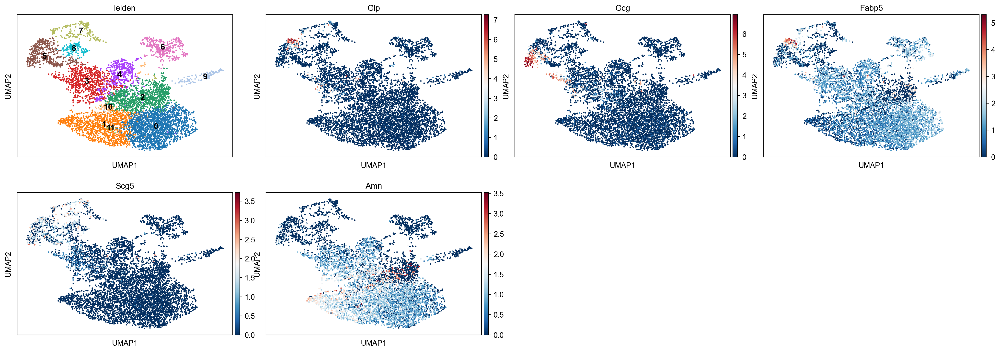

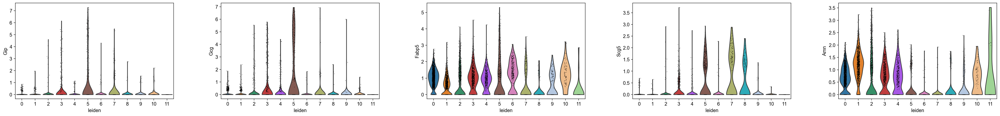

,group,names,scores,logfoldchanges,pvals,pvals_adj
19589,1,Amn,32.296822,1.484414,4.286446e-176,6.335822e-174
97743,5,Scg5,15.418026,3.483845,1.689595e-43,2.635146e-42
1405,0,Fabp5,14.568617,0.567631,4.061674e-47,4.452097e-46
97802,5,Gcg,13.549189,4.410521,2.472324e-35,3.080301e-34
136642,7,Scg5,11.479810,3.667936,9.383322e-24,1.294762e-22
98134,5,Gip,8.983487,4.070472,7.213358e-18,4.929591e-17
117562,6,Fabp5,8.474396,0.774499,4.278738e-16,5.050361e-15
156342,8,Scg5,7.489391,2.752198,6.436195e-12,4.740528e-11
58792,3,Gcg,7.133424,1.671962,2.201537e-12,1.274605e-10
58888,3,Fabp5,6.285623,0.394749,4.997688e-10,2.088006e-08


../resources/adata_17_frozen.h5ad
Checking Other_Genes


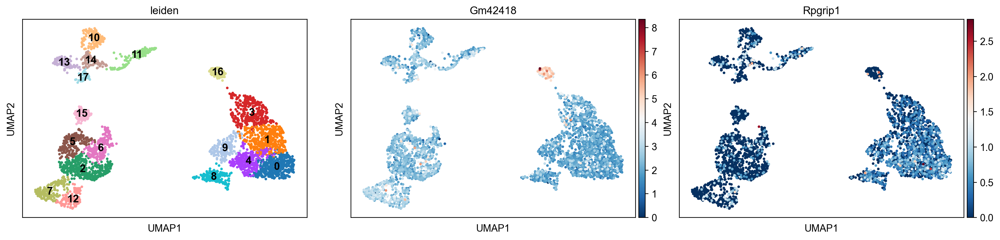

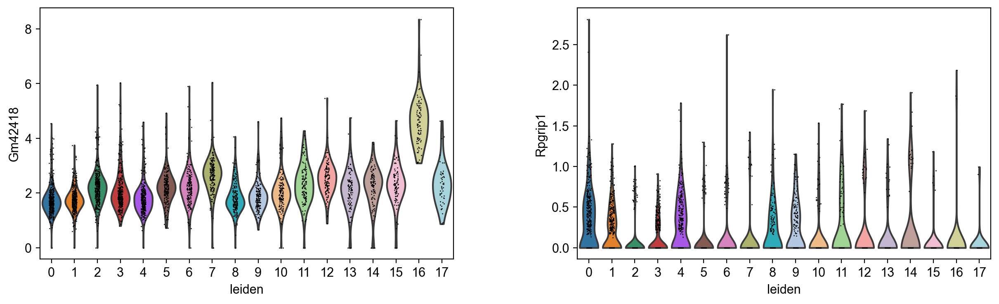

,group,names,scores,logfoldchanges,pvals,pvals_adj
289910,16,Gm42418,27.821543,3.839397,8.155784e-47,8.196042e-46
126984,7,Gm42418,10.945237,0.868648,2.372356e-22,4.036124e-21
1397,0,Rpgrip1,9.638305,1.236984,3.209427e-20,2.059922e-19
217619,12,Gm42418,8.115036,0.678447,1.627757e-13,1.897898e-12
73979,4,Rpgrip1,7.272790,0.994371,2.240663e-12,1.221377e-11
21560,1,Rpgrip1,4.129364,0.483296,4.228519e-05,1.134555e-04
165103,9,Rpgrip1,3.244308,0.586336,1.399305e-03,7.277268e-03
200794,11,Gm42418,3.235033,0.340373,1.509346e-03,5.478334e-03
109728,6,Gm42418,2.645259,0.220321,8.726626e-03,2.359262e-02
148486,8,Rpgrip1,2.469344,0.469854,1.439246e-02,3.450343e-02


Checking Pancreas


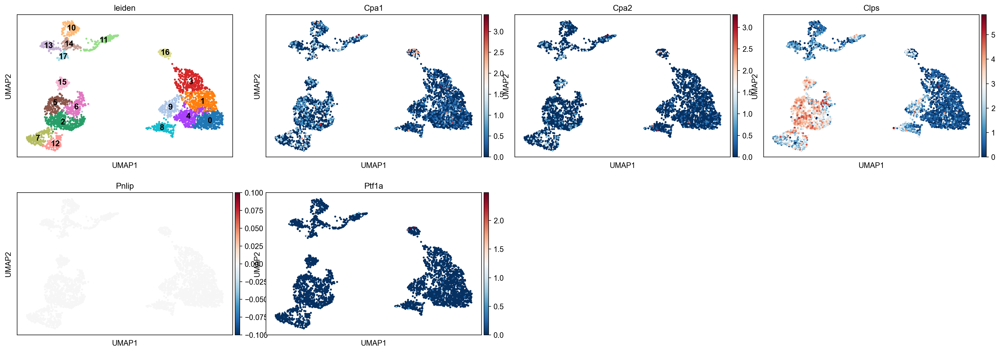

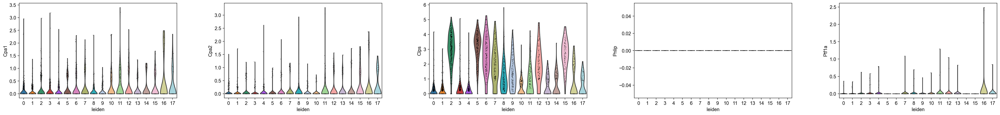

,group,names,scores,logfoldchanges,pvals,pvals_adj
36254,2,Clps,34.022877,3.498468,1.932480e-132,2.465817e-130
90613,5,Clps,29.492006,3.520115,8.074251e-85,9.201091e-83
108733,6,Clps,15.672620,2.547998,5.721531e-38,2.308873e-36
271806,15,Clps,14.681458,2.595422,1.814749e-27,4.717567e-26
127123,7,Clps,7.572038,1.378098,1.253153e-12,1.178302e-11
217716,12,Clps,6.695724,1.352197,4.462854e-10,3.823284e-09
272061,15,Cpa2,4.055432,2.341115,1.003336e-04,4.140159e-04
200586,11,Cpa1,3.541243,1.321329,5.457668e-04,2.227196e-03
290129,16,Cpa1,3.321544,1.926551,1.291138e-03,2.513942e-03
308329,17,Cpa2,3.163051,2.299584,2.696638e-03,8.709516e-03


Checking K/L Cells


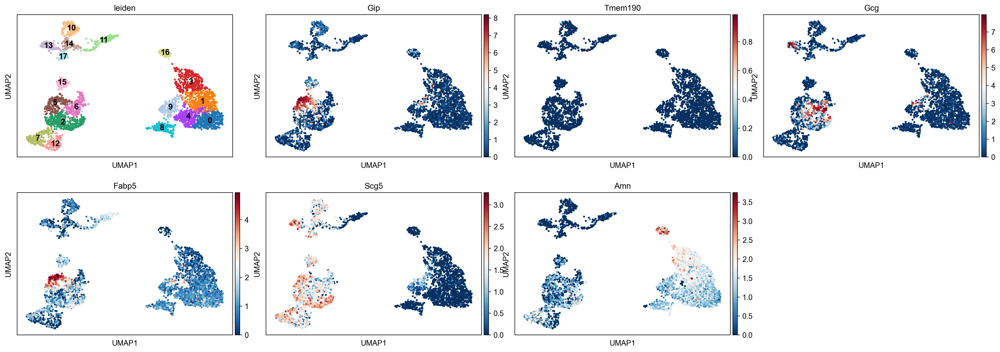

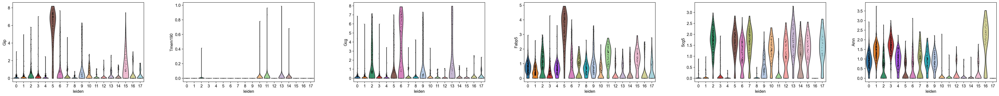

,group,names,scores,logfoldchanges,pvals,pvals_adj
54456,3,Amn,36.454941,2.211804,1.155192e-140,1.300058e-138
36256,2,Scg5,33.645233,2.626975,2.692745e-133,3.535496e-131
90610,5,Gip,30.608524,9.342248,8.705080e-80,8.214966e-78
90612,5,Fabp5,29.712946,4.719450,2.097641e-78,1.929297e-76
18321,1,Amn,25.644430,1.560254,3.018840e-100,1.353920e-98
90636,5,Scg5,20.323111,2.231816,9.096415e-55,4.861886e-53
126892,7,Scg5,16.444803,2.129366,2.635552e-39,9.183378e-38
235587,13,Scg5,13.942031,2.266592,2.628090e-26,5.622002e-25
108758,6,Gcg,12.367405,5.366552,1.507263e-26,3.901442e-25
181337,10,Scg5,10.383446,1.394444,7.987114e-20,8.558162e-19


In [3]:
batches = ['12', '15', '17']
file_template = '../resources/adata_{}_frozen.h5ad'
for batch in batches:
    filename = file_template.format(batch)
    print(filename)
    adata = sc.read_h5ad(filename)
    # Need a little bit fix for key error
    if ('log1p' in adata.uns.keys()) and ('base' not in adata.uns['log1p'].keys()):
        adata.uns['log1p']['base'] = 2
    for key, genes in checking_genes.items():
        print('Checking {}'.format(key))
        genes = [(gene[0] + gene[1:].lower()) for gene in genes]
        check_pancreatic_genes(adata, genes)
    del adata

#### The following cells are used to remove clusters 3 and 4 from an old frozen adata file. However, since these clsuters were removed, the following statements may not create any new output. It basically shows the stability of the results if these clsuters have been removed.

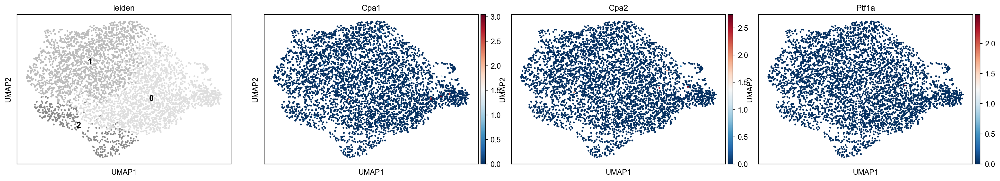

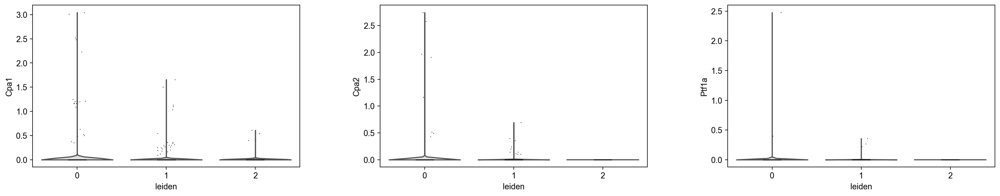

,group,names,scores,logfoldchanges,pvals,pvals_adj
235,0,Cpa2,1.899028,2.304260,0.057691,0.099342
278,0,Cpa1,1.805821,1.064916,0.071051,0.119594
1522,0,Ptf1a,0.808142,1.824924,0.419096,0.528022
32721,1,Ptf1a,-0.669723,-1.339135,0.503091,0.618568
50235,2,Ptf1a,-1.455373,-19.879913,0.145647,0.284987
34439,1,Cpa1,-1.501173,-0.837347,0.133394,0.218597
34675,1,Cpa2,-1.677225,-1.817905,0.093612,0.162470
50845,2,Cpa1,-1.717055,-1.186353,0.086323,0.199152
52328,2,Cpa2,-2.881133,-21.825859,0.003984,0.019351


In [15]:
# Based on the above results, clusters 3 and 4 in E12.2 will be removed. However, nothing will be removed in E15.5 and E17.5.
adata_e12_file = '../resources/adata_12_frozen.h5ad'
adata_e12 = sc.read_h5ad(adata_e12_file)
pancreatic_genes = ['Cpa1', 'Cpa2', 'Ptf1a']
check_pancreatic_genes(adata=adata_e12, genes=pancreatic_genes)

In [16]:
adata_e12_no_3_4 = adata_e12[~(adata_e12.obs['leiden'].isin(['3', '4']))]
print('Before removing clusters 3 and 4: \n{}'.format(adata_e12))
print('After removing clusters 3 and 4: \n{}'.format(adata_e12_no_3_4))
total_removed = adata_e12.shape[0] - adata_e12_no_3_4.shape[0]
print('Removed cells: {}'.format(total_removed))

Before removing clusters 3 and 4: 
AnnData object with n_obs × n_vars = 4210 × 17800
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'CytoTRACE', 'leiden', 'dpt_pseudotime'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'diffmap_evals', 'hvg', 'iroot', 'leiden', 'leiden_colors', 'leiden_sizes', 'neighbors', 'paga', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_aucell', 'X_diffmap', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts'
    obsp: 'connectivities', 'distances'
After removing clusters 3 and 4: 
View of AnnData object with n_obs × n_vars = 4210 × 17800
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'CytoTRACE', 'leiden', 'dpt_pseudotime'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts

In [17]:
# Re-clustering and re-umap: use the same method as before
# The resolution has been set to 0.25. With leidenalg-0.9.1, we need to have this resolution to
# get 5 clusters for the originally frozen data. Therefore, 0.25 is used here.
# Technically it is better to run umap first and then paga. Otherwie, using paga as
# init position may force the clusters overlapping much easier.
helper.run_umap(adata_e12_no_3_4, leiden_resolution=0.25, need_run_variable=True) # Since we have removed cells, run highly variable genes again
helper.run_paga(adata_e12_no_3_4)

In [18]:
# Need to re-run dpt since the iroot may change. iroot use the integer location, which will be change here.
# Also the scale may change too
# Get root cell
root_cell = adata_e12_no_3_4.obs['CytoTRACE'].idxmax()
print('Found root_cell: {}'.format(root_cell))
adata_e12_no_3_4.uns['iroot'] = np.flatnonzero(adata_e12_no_3_4.obs_names==root_cell)[0]
print("The root cell's index: {}".format(adata_e12_no_3_4.uns['iroot']))
sc.tl.dpt(adata_e12_no_3_4)

Found root_cell: CGAGAAGGTTGTGGCC-1
The root cell's index: 1560


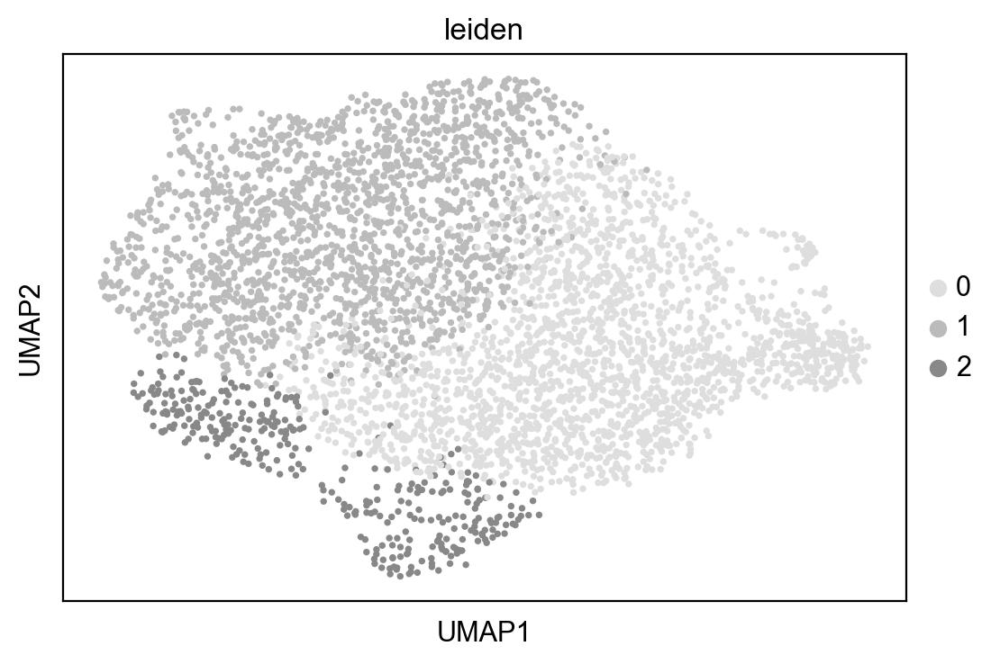

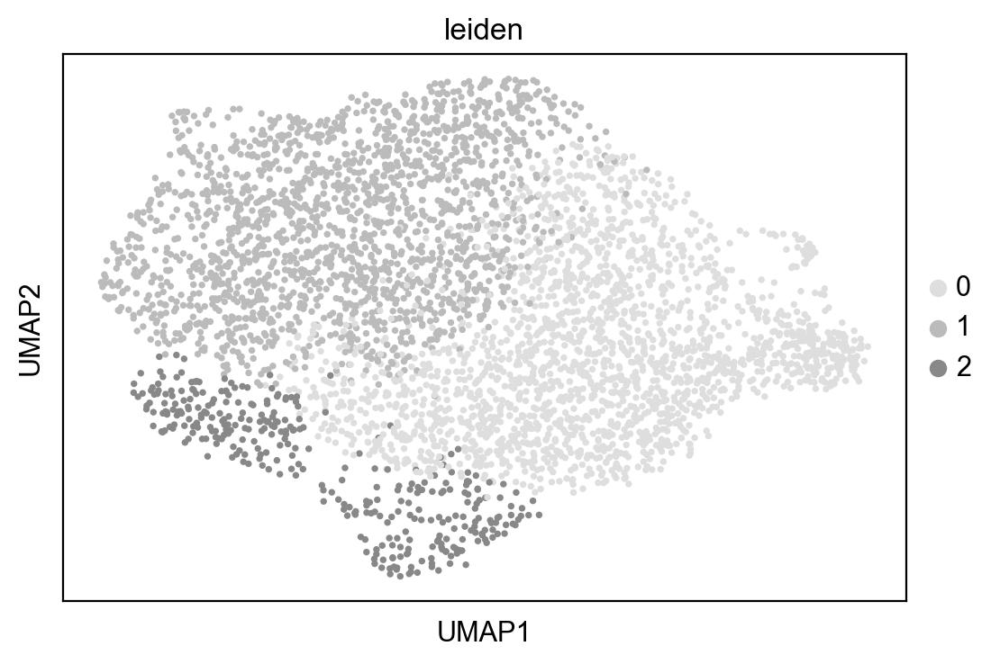

In [19]:
sc.pl.umap(adata_e12_no_3_4, color=['leiden'])
sc.pl.umap(adata_e12, color=['leiden'])

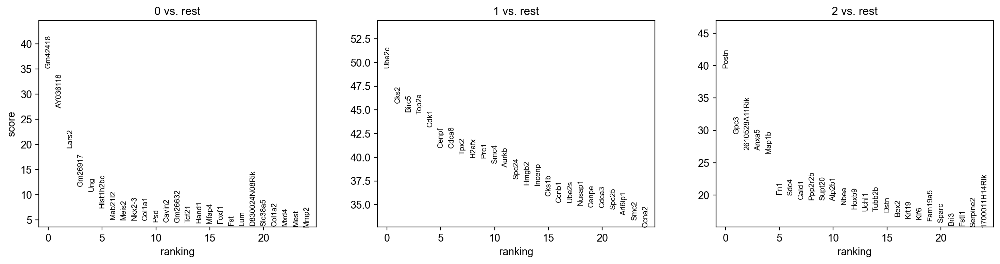

(4420, 6)
group
0     121
2    1547
1    2752
Name: names, dtype: int64


In [20]:
# Re-generate the markers
helper.analyze_markers(adata_e12_no_3_4, 
                       save_plot='_adata_e12_no_3_4.pdf', 
                       save_markers=out_dir + 'adata_e12_no_3_4_markers.csv')

In [21]:
# Save the final out, which will be used for the frozen data
adata_e12_no_3_4.write_h5ad(out_dir + 'adata_e12_no_cluster_3_4_091323.h5ad')

#### Some comparison checks between the previous clusters and the current clusters.

In [22]:
# Check the overlapping between the new clustering results and the old one
adata_e12_original_leiden = adata_e12.obs['leiden'].loc[adata_e12_no_3_4.obs['leiden'].index]
ari(adata_e12_no_3_4.obs['leiden'], adata_e12_original_leiden)

1.0

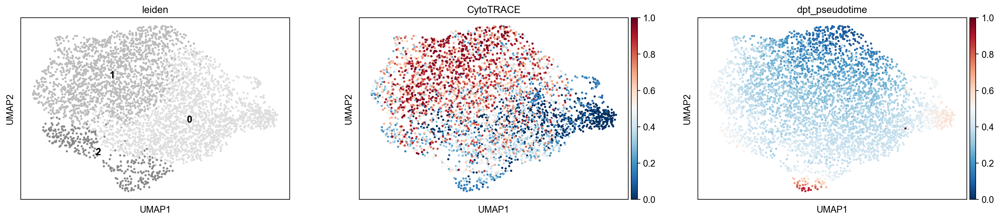

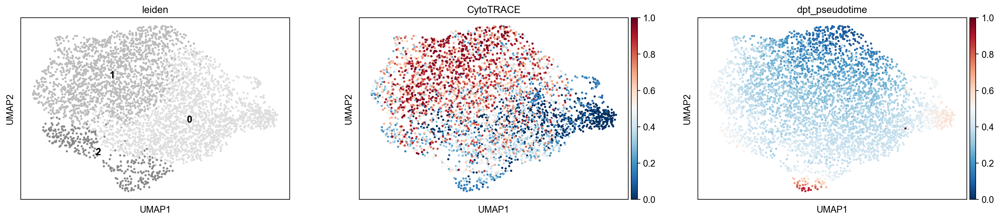

In [23]:
sc.pl.umap(adata_e12_no_3_4, color=['leiden', 'CytoTRACE', 'dpt_pseudotime'], legend_loc='on data')
sc.pl.umap(adata_e12, color=['leiden', 'CytoTRACE', 'dpt_pseudotime'], legend_loc='on data')

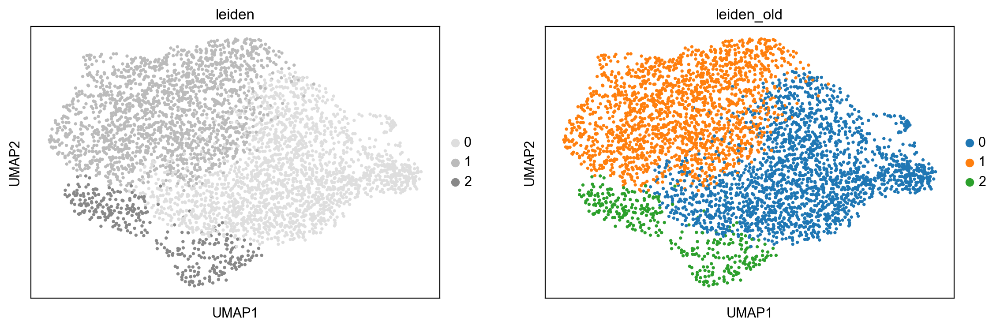

In [24]:
adata_e12_no_3_4.obs['leiden_old'] = adata_e12.obs['leiden'].loc[adata_e12_no_3_4.obs['leiden'].index]
sc.pl.umap(adata_e12_no_3_4, color=['leiden', 'leiden_old'])

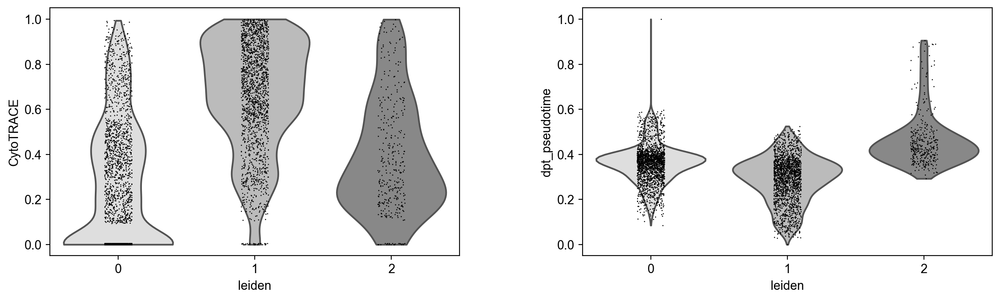

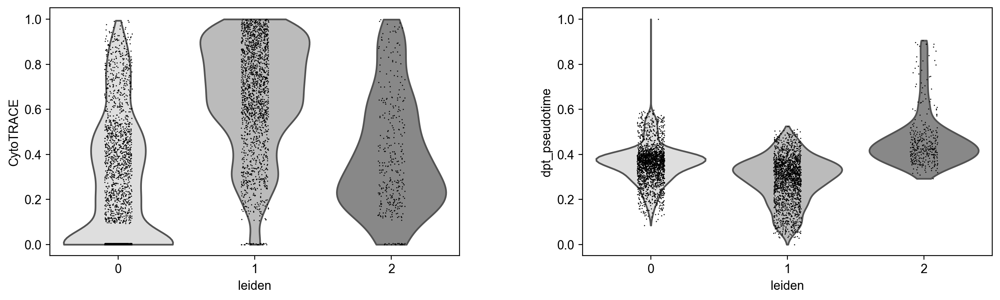

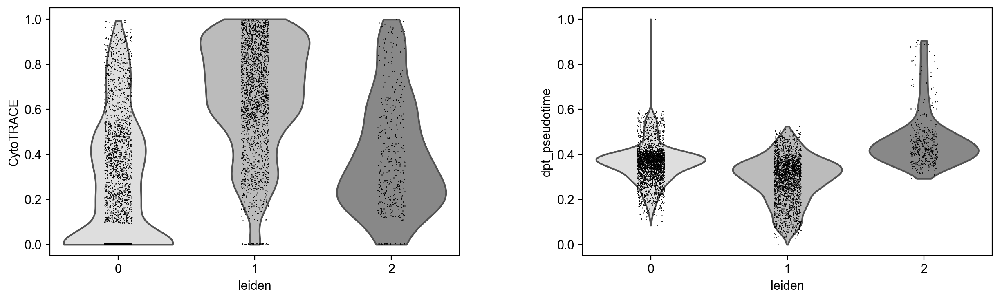

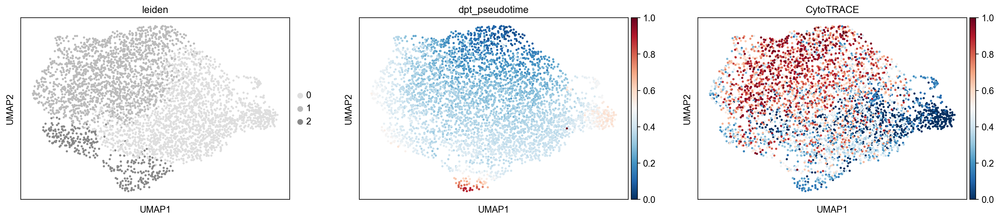

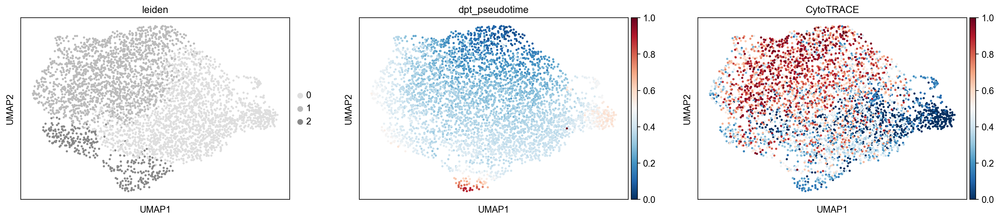

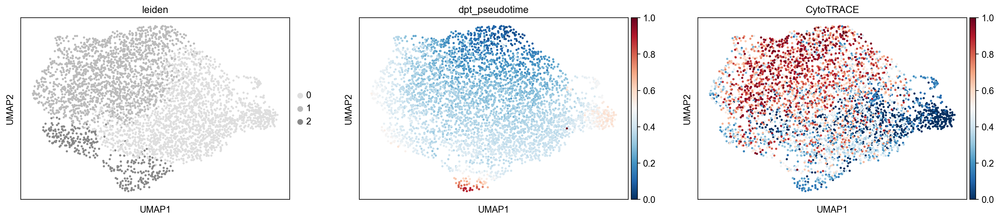

In [25]:
# Just remove  clusters 3 and 4 without re-clustering.
adata_e12_no_3_4_no_recluster = adata_e12[~adata_e12.obs['leiden'].isin(['3', '4'])]

sc.pl.violin(adata_e12_no_3_4, keys=['CytoTRACE', 'dpt_pseudotime'], groupby='leiden')
sc.pl.violin(adata_e12, keys=['CytoTRACE', 'dpt_pseudotime'], groupby='leiden')
sc.pl.violin(adata_e12_no_3_4_no_recluster, keys=['CytoTRACE', 'dpt_pseudotime'], groupby='leiden')
sc.pl.umap(adata_e12_no_3_4, color=['leiden', 'dpt_pseudotime', 'CytoTRACE'])
sc.pl.umap(adata_e12, color=['leiden', 'dpt_pseudotime', 'CytoTRACE'])
sc.pl.umap(adata_e12_no_3_4_no_recluster, color=['leiden', 'dpt_pseudotime', 'CytoTRACE'])